<h1 align="center">Volume 2: The Fourier Transform.</h1>

    <Name> Sukyoung Kwak
    <Class> 321 - 2
    <Date> December 8th

<h2 align="center">Part 1: The Discrete Fourier Transform</h2>

In [46]:
from matplotlib import pyplot as plt
from scipy.io import wavfile
import numpy as np
import IPython
from scipy.fftpack import fft, ifft,fft2,ifft2
from scipy.linalg import dft
from scipy import signal
from scipy.linalg import dft
import imageio
from scipy import signal
import imageio

In [47]:
!pip install ipython

In [48]:
plt.rcParams["figure.dpi"] = 300             # Fix plot quality.
plt.rcParams["figure.figsize"] = (12,3)      # Change plot size / aspect (you may adjust this).

In [49]:
class SoundWave(object):
    """A class for working with digital audio signals."""

    # Problem 1.1
    def __init__(self, rate, samples):
        """Set the SoundWave class attributes.

        Parameters:
            rate (int): The sample rate of the sound.
            samples ((n,) ndarray): NumPy array of samples.
        """
        self.rate = rate
        self.samples = samples
        #(1.1) formula
        self.second = len(self.samples)/self.rate

    # Problems 1.1 and 1.7
    def plot(self,Christian=False):
        """Plot the graph of the sound wave (time versus amplitude)."""
        #if it's true
        if Christian==True:
            #Get the dft
            user_dft = fft(self.samples)
            #get x values
            x = np.linspace(0,self.rate/2, len(self.samples)//2)
            #plot
            plt.plot(x//self.second, np.abs(user_dft[:len(user_dft)//2]))
            plt.xlabel("Frequency(Hz)",fontsize = 10)
            plt.ylabel("Magnitude", fontsize = 10)
            plt.show()
            
        #setting the domain
        x = np.linspace(0, self.second, len(self.samples))
        #plot with the y values = self.samples
        plt.plot(x, self.samples)
        plt.ylim([-32768,32767])
        
        #plotting the labels
        plt.xlabel("Time(seconds)",fontsize = 20)
        plt.ylabel("samples", fontsize = 20)
    
    # Problem 1.2
    def export(self, filename, force=False):
        """Generate a wav file from the sample rate and samples. 
        If the array of samples is not of type np.int16, scale it before exporting.

        Parameters:
            filename (str): The name of the wav file to export the sound to.
        """
        #if the sample is not np.1nt16 or force is true
        if force or (self.samples.dtype != np.int16):
            self.samples = np.int16((self.samples)/max(abs(self.samples))*32767)
        #The change    
        wavfile.write(filename, self.rate, self.samples)
        
    # Problem 1.4
    def __add__(self, other):
        """Combine the samples from two SoundWave objects.

        Parameters:
            other (SoundWave): An object containing the samples to add
                to the samples contained in this object.
        
        Returns:
            (SoundWave): A new SoundWave instance with the combined samples.

        Raises:
            ValueError: if the two sample arrays are not the same length.
        """
        #if the sample arrays from A and B are not the same length
        if len(self.samples) != len(other.samples):
            raise ValueError("A and B are not the same length.")
        return SoundWave(self.rate, self.samples + other.samples)

    # Problem 1.4
    def __rshift__(self, other):
        """Concatentate the samples from two SoundWave objects.

        Parameters:
            other (SoundWave): An object containing the samples to concatenate
                to the samples contained in this object.

        Raises:
            ValueError: if the two sample rates are not equal.
        """
        #if sample rates from the two objects are not equal
        if self.rate != other.rate:
            raise ValueError("A and B don't have the same rates.")
        #
        new_samples = np.concatenate((self.samples, other.samples))
        return SoundWave(self.rate, new_samples)
    
    # Problem 2.1
    def __mul__(self, other):
        """Convolve the samples from two SoundWave objects using circular convolution.
        
        Parameters:
            other (SoundWave): An object containing the samples to convolve
                with the samples contained in this object.
        
        Returns:
            (SoundWave): A new SoundWave instance with the convolved samples.

        Raises:
            ValueError: if the two sample rates are not equal.
        """
        #if the sample rates from A and B are not equal.
        if self.rate != other.rate:
            raise ValueError("The sample rates from A and B are not equal.")
        #Don't have the same length of the samples
        
        if (len(self.samples) < len(other.samples)):
            a = len(other.samples) - len(self.samples)
            for i in range(a):
                self.samples = np.append(self.samples,0)
        elif (len(other.samples) < len(self.samples)):
            a = len(self.samples) - len(other.samples)
            for i in range(a):
                other.samples = np.append(other.samples,0)
                
        convolution = ifft(fft(self.samples)*fft(other.samples)).real
                
        return SoundWave(self.rate, convolution)

    # Problem 2.2
    def __pow__(self, other):
        """Convolve the samples from two SoundWave objects using linear convolution.
        
        Parameters:
            other (SoundWave): An object containing the samples to convolve
                with the samples contained in this object.
        
        Returns:
            (SoundWave): A new SoundWave instance with the convolved samples.

        Raises:
            ValueError: if the two sample rates are not equal.
        """
        #if the sample rates from A and B are not equal.
        if self.rate != other.rate:
            raise ValueError("The sample rates from A and B are not equal.")
        #computing the smallest 2^a
        n = len(self.samples)
        m = len(other.samples)
        a = 1
        while((2**a) < n+m-1):
            a += 1
        #append zeros to each samples so that they each have 2**a entries
        while (len(self.samples)<2**a):
            self.samples = np.append(self.samples,0)
        while (len(other.samples)<2**a):
            other.samples = np.append(other.samples,0)
                
        convolution = ifft(fft(self.samples[:n+m-1])*fft(other.samples[:n+m-1])).real
                
        return SoundWave(self.rate, convolution)

    # Problem 2.4
    def clean(self, low_freq, high_freq):
        """Remove a range of frequencies from the samples using the DFT. 

        Parameters:
            low_freq (float): Lower bound of the frequency range to zero out.
            high_freq (float): Higher boound of the frequency range to zero out.
        """
        #compute the DFT of the stored samples
        user_dft = fft(self.samples)
        
        #calculating k_low, k_high
        k_low = int(low_freq*len(self.samples)/self.rate)
        k_high = int(high_freq*len(self.samples)/self.rate)
        
        n = len(user_dft)
        #zero out the frequencies in the range [k_low, k_high]
        for i in range(k_low, k_high+1):
            user_dft[i] = 0
        for i in range(n-k_high, n-k_low):
            user_dft[i] = 0
        
        self.samples = ifft(user_dft).real

### Problem 1.1

- Implement `SoundWave.__init__()`.
- Implement `SoundWave.plot()`.
- Use the `scipy.io.wavfile.read()` and the `SoundWave` class to plot `tada.wav`.

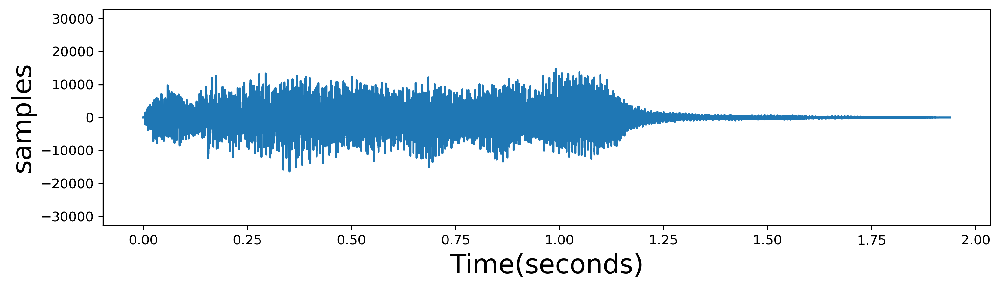

In [50]:
rate, samples = wavfile.read("tada.wav")
sam = SoundWave(rate, samples)
sam.plot()

### Problem 1.2

- Implement `SoundWave.export()`.
- Use the `export()` method to create two new files containing the same sound as `tada.wav`: one without scaling, and one with scaling (use `force=True`).
- Use `IPython.display.Audio()` to embed the original and new versions of `tada.wav` in the notebook.

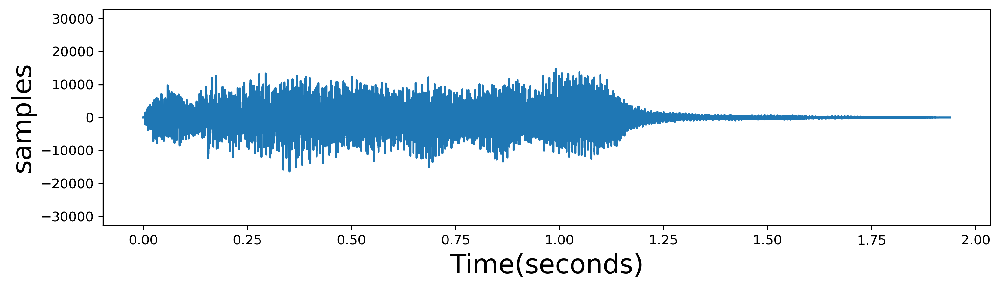

In [51]:
rate, samples = wavfile.read("tada.wav")
sam = SoundWave(rate, samples)
sam.plot()
IPython.display.Audio(filename="tada.wav")

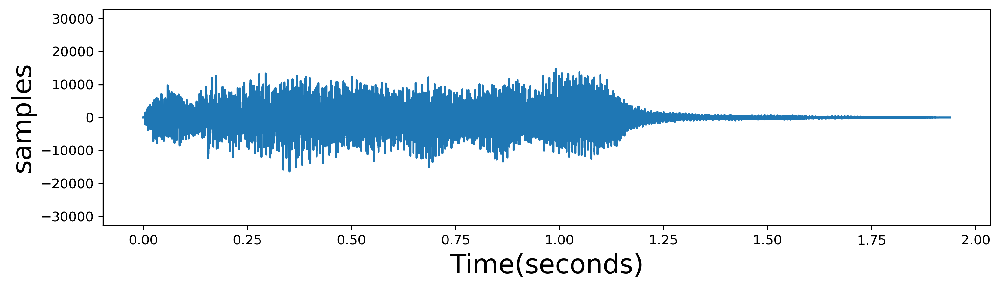

In [52]:
rate,samples = wavfile.read("tada.wav")
sam = SoundWave(rate, samples)
sam.export("tada_new1.wav")
sam.plot()
IPython.display.Audio(filename="tada_new1.wav")

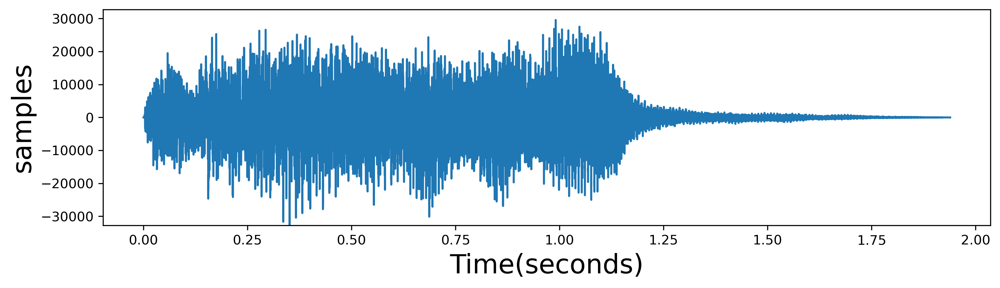

In [53]:
rate,samples = wavfile.read("tada.wav")
sam = SoundWave(rate, samples)
sam.export("tada_new2.wav",True)
sam.plot()
IPython.display.Audio(filename="tada_new2.wav")

### Problem 1.3

- Implement `generate_note()`.
- Use `generate_note()` to create an A tone that lasts for two seconds. Embed it in the notebook.

In [54]:
def generate_note(frequency, duration):
    """Generate an instance of the SoundWave class corresponding to 
    the desired soundwave. Uses sample rate of 44100 Hz.
    
    Parameters:
        frequency (float): The frequency of the desired sound.
        duration (float): The length of the desired sound in seconds.
    
    Returns:
        sound (SoundWave): An instance of the SoundWave class.
    """
    #set the domain
    domain = np.linspace(0, duration, 44100*duration)
    #return the soundwave
    return SoundWave(44100, np.sin(2*np.pi*domain*frequency))
    

In [55]:
new = generate_note(440,2)
new.export("question3.wav")
IPython.display.Audio("question3.wav")

### Problem 1.4

- Implement `SoundWave.__add__()`.
- Generate a three-second A minor chord (A, C, and E) and embed it in the notebook.
- Implement `SoundWave.__rshift__()`.
- Generate the arpeggio A$\,\rightarrow\,$C$\,\rightarrow\,$E, where each tone lasts one second, and embed it in the notebook.

In [56]:
A = generate_note(440, 3)
C = generate_note(523.25, 3)
E = generate_note(659.25, 3)
A_C_E = A+C+E
A_C_E.export("add.wav")
IPython.display.Audio(filename="add.wav")

A_C_E.export("add.wav")
IPython.display.Audio(filename="add.wav")

In [57]:
A = generate_note(440, 1)
C = generate_note(523.25, 1)
E = generate_note(659.25, 1)
A_C_E = A>>C>>E

A_C_E.export("shift.wav")
IPython.display.Audio(filename="shift.wav")

### Problem 1.5

- Implement `simple_dft()` with the formula $c=F_nf$, where $F_n$ is the n-dimensional DFT matrix.
- Use `np.allclose()` to check that `simple_dft()` and `scipy.fftpack.fft()` give the same result (after scaling).

In [58]:
def simple_dft(samples):
    """Compute the DFT of an array of samples.

    Parameters:
        samples ((n,) ndarray): an array of samples.
    
    Returns:
        ((n,) ndarray): The DFT of the given array.
    """
    #getting the size of the samples
    n = len(samples)
    #getting w
    w = np.exp(2*np.pi*1j/n)
    #initializng Fn
    Fn = np.vectorize(complex)(np.zeros((n,n)))
    #assigning Fn
    for i in range(n):
        Fn[:,i] = [w**(-i*k) for k in range(n)]
    return np.dot(Fn/n ,samples)

In [59]:
f = np.arange(20)
print(np.allclose(simple_dft(f)*20,fft(f)))

True


### Problem 1.6

- Implement `simple_fft()`.
- Generate an array of $8192$ random samples and take its DFT using `simple_dft()`, `simple_fft()`, and `scipy.fftpack.fft()`.
Print the runtimes of each computation.
- Use `np.allclose()` to check that `simple_fft()` and `scipy.fftpack.fft()` give the same result (after scaling).

In [60]:
def simple_fft(samples, threshold=1):
    """Compute the DFT using the FFT algorithm.
    
    Parameters:
        samples ((n,) ndarray): an array of samples.
        threshold (int): when a subarray of samples has fewer
            elements than this integer, use simple_dft() to
            compute the DFT of that subarray.
    
    Returns:
        ((n,) ndarray): The DFT of the given array.
    """
    #define the new method, split
    def split(g_sample):
        #get the length
        n = len(g_sample)
        #if n is too small
        if n <= threshold:
            return n*simple_dft(g_sample)
        else:
            even = split(g_sample[::2])
            odd = split(g_sample[1::2])
            #set z
            z = np.array([np.exp(-2*np.pi*1j*k/n) for k in range(n)])
            m = n//2
            return np.concatenate((even+(z[:m]*odd), even+(z[m:]*odd)))
    return split(samples)/len(samples)

In [61]:
samples = np.arange(8192)
print(np.allclose(simple_fft(samples)*8192,fft(samples)))

True


In [62]:
%time sim_dft = simple_dft(samples)

CPU times: user 34.4 s, sys: 3.96 s, total: 38.4 s
Wall time: 40.4 s


In [63]:
%time sim_fft = simple_fft(samples)

CPU times: user 747 ms, sys: 204 ms, total: 951 ms
Wall time: 290 ms


### Problem 1.7

- Modify `SoundWave.plot()` so that it accepts a boolean. When the boolean is `True`, take the DFT of the stored samples and plot (in a new subplot) the frequencies present on the $x$-axis and the magnituds of those frequences on the $y$-axis. Only the display the first half of the plot, and adjust the $x$-axis so that it correctly shows the frequencies in Hertz.
- Display the plot of the DFT of an A tone.
- Display the plot of the DFT of an A minor chord.

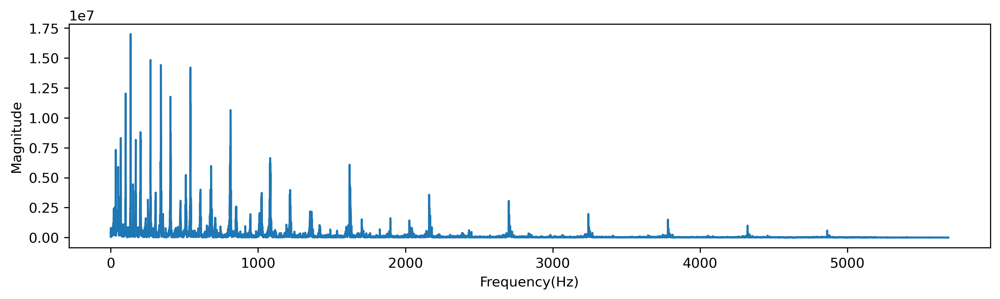

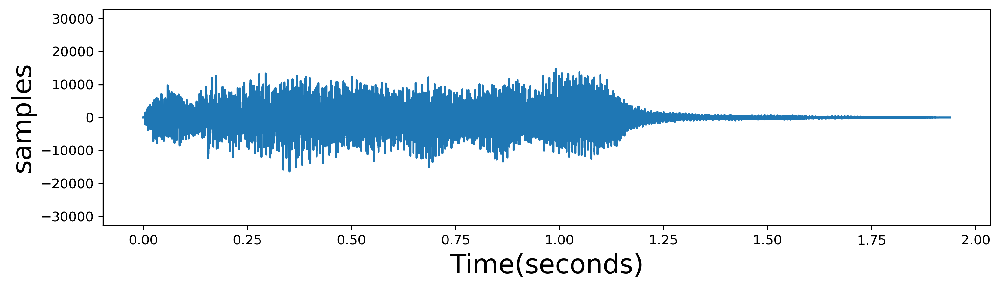

In [64]:
rate, samples = wavfile.read("tada.wav")
sam = SoundWave(rate, samples)
sam.plot(True)

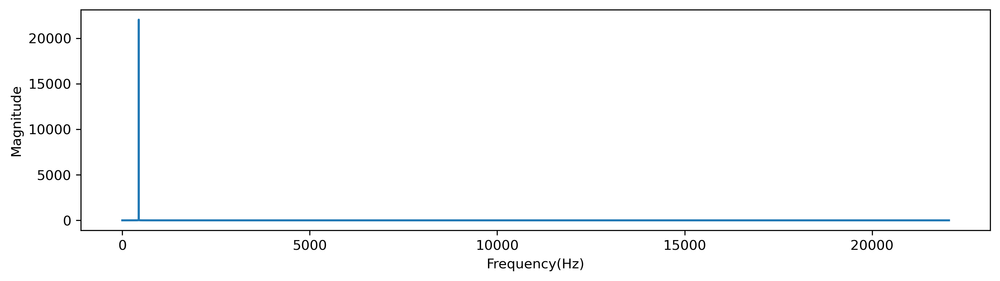

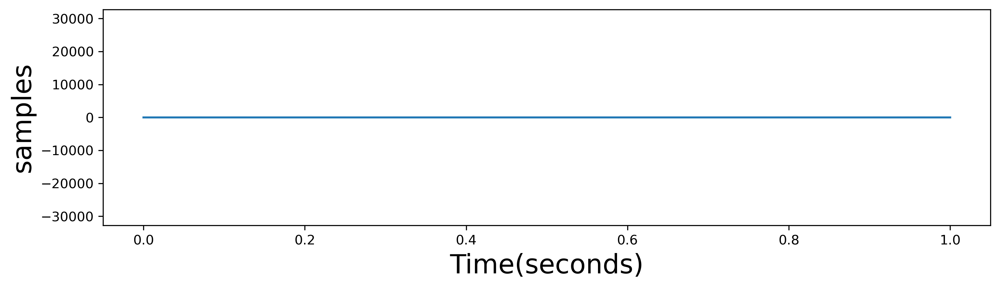

In [65]:
A = generate_note(440, 1)
A_M = generate_note(880, 1)

A.plot(True)

### Problem 1.8

Use the DFT to determine the individual notes that are present in `mystery_chord.wav`.

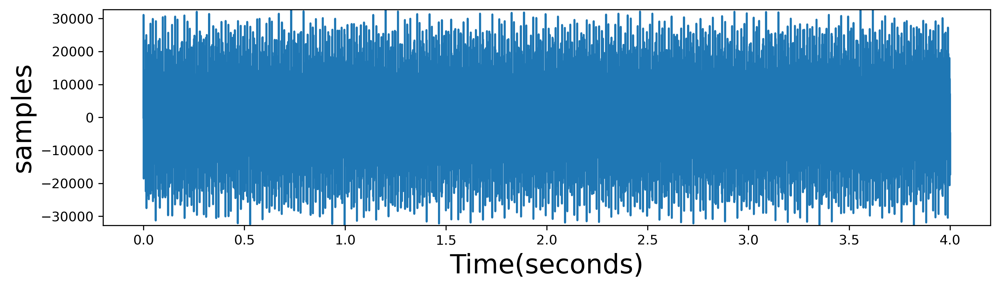

In [66]:
rate,samples = wavfile.read("mystery_chord.wav")
sam = SoundWave(rate, samples)
sam.export("mystery_1.wav")
sam.plot()
IPython.display.Audio(filename="mystery_1.wav")

In [67]:
A = generate_note(440, 2)
B = generate_note(498.88, 2)
C = generate_note(523.25, 2)
D = generate_note(587.33, 2)
E = generate_note(659.25, 2)
F = generate_note(698.46, 2)
G = generate_note(783.99, 2)
A_M = generate_note(880, 2)
G_A_C_D = G+A+C+D
G_A_C_D.export("G_A_C_D.wav")
IPython.display.Audio(filename="G_A_C_D.wav")

#Found out there are G,A,C,D in the chord.
#I have relative pitch and my siblings have perfect pitch which is not related to this work but ... yea.


The notes are...

<h2 align="center">Part 2: Convolution and Filtering.</h2>

### Problem 2.1

- Implement `SoundWave.__mul__()` for circular convolution.
- Generate 2 seconds of white noise at the same sample rate as `tada.wav`.
- Compute the circular convolution of `tada.wav` and the white noise. Embed the result in the notebook.
- Append the circular convolution to itself and embed the result in the notebook.

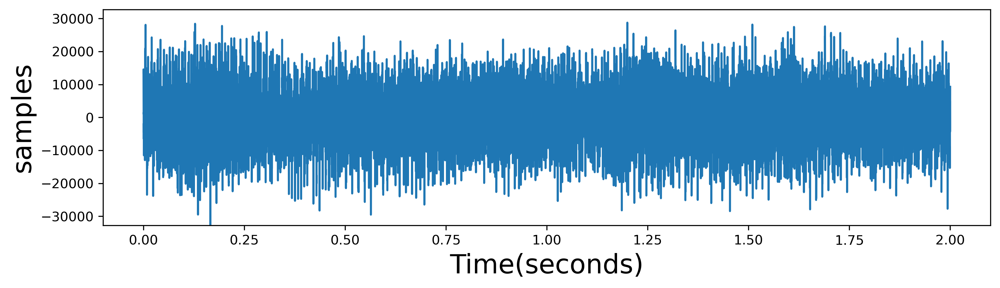

In [68]:
#ctrv from the pdf
rate1 = 22050
white_noise = np.random.randint(-32767, 32767, rate1*2, dtype=np.int16)
#get tada sounds' info
rate,samples = wavfile.read("tada.wav")
Dustin = SoundWave(rate, samples)
#set white_noise
Momo = SoundWave(rate1, white_noise)
#convolve both
mul = Dustin * Momo 
mul.export("mul.wav")
mul.plot()
IPython.display.Audio(filename="mul.wav")

In [69]:
IPython.display.Audio(filename="tada.wav")

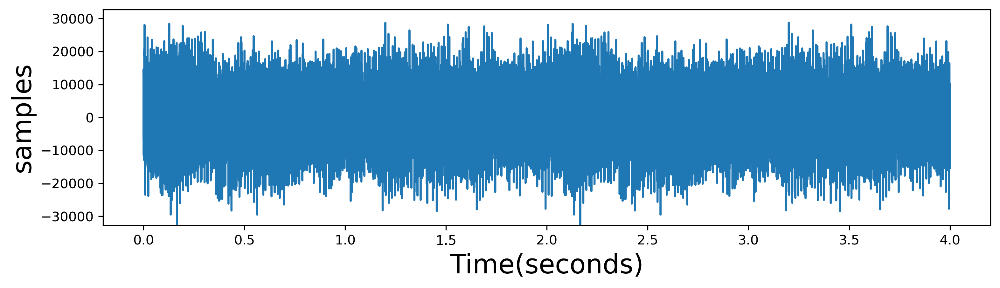

In [70]:
#append to the convolve sound
result = mul >> mul
#display the sound
result.export("result.wav")
result.plot()
IPython.display.Audio(filename="result.wav")

### Problem 2.2

- Implement `SoundWave.__pow__()` for linear convolution.
- Time the linear convolution of `CGC.wav` and `GCG.wav` using `SoundWave.__pow__()` and `scipy.signal.fftconvolve()`.
- Embed the two original sounds and their convolutions in the notebook. Check that the convolutions with `SoundWave.__pow__()` and `scipy.signal.fftconvolve()` sound the same.

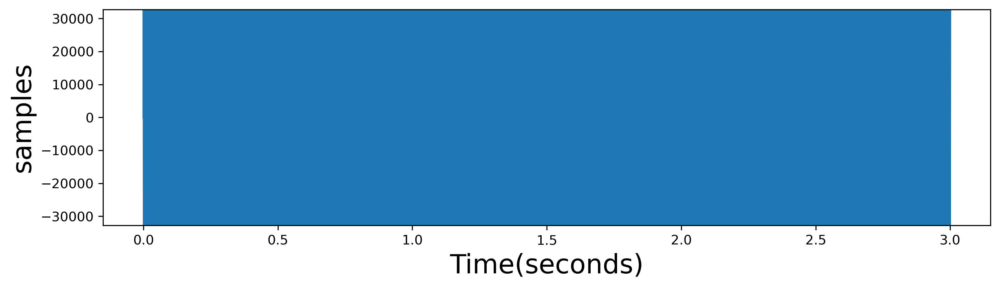

In [71]:
#cgc sound
rate,Csamples = wavfile.read("CGC.wav")
CGC = SoundWave(rate, Csamples)
CGC.plot()
IPython.display.Audio(filename="CGC.wav")

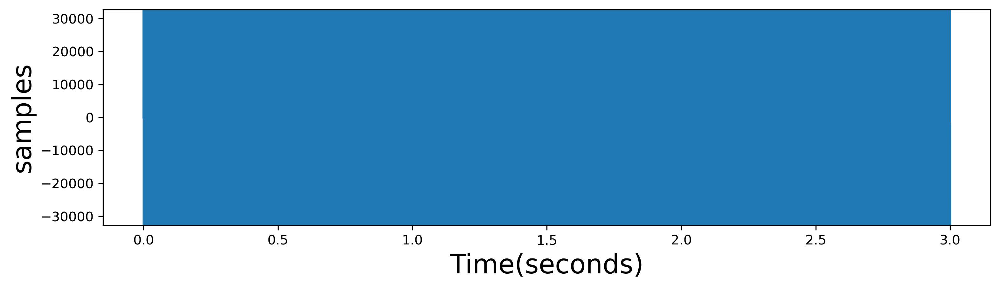

In [72]:
#gcg sound
rate,Gsamples = wavfile.read("GCG.wav")
GCG = SoundWave(rate, Gsamples)
GCG.plot()
IPython.display.Audio(filename="GCG.wav")

CPU times: user 1min 8s, sys: 162 ms, total: 1min 9s
Wall time: 1min 9s


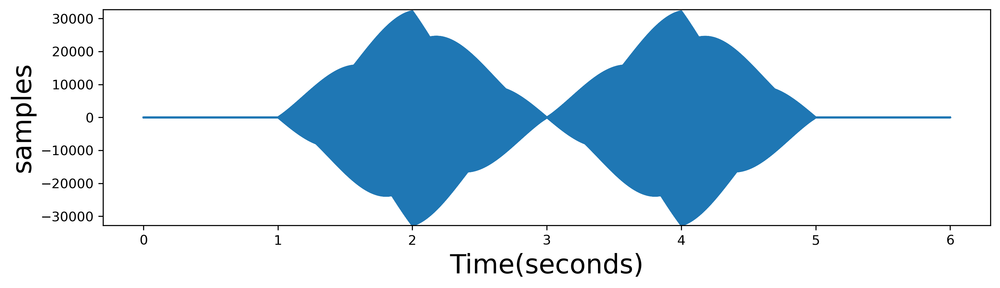

In [73]:
#time the power
%time power = CGC ** GCG
power.export("power.wav")
power.plot()
IPython.display.Audio(filename="power.wav")

CPU times: user 7.26 ms, sys: 3.19 ms, total: 10.5 ms
Wall time: 9.3 ms


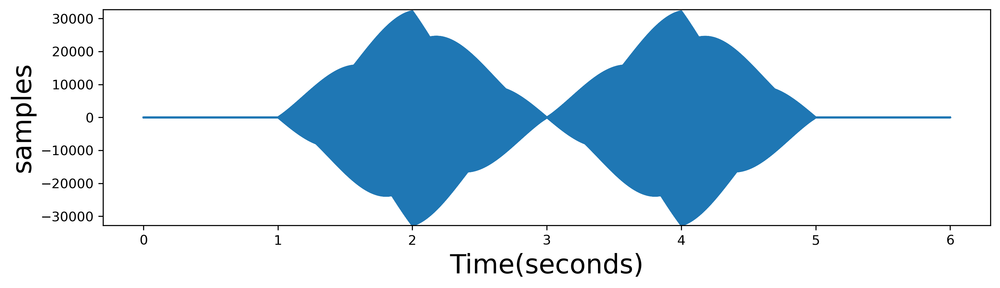

In [74]:
#time signal.fftconvole to compare
%time sci_sig = signal.fftconvolve(Csamples, Gsamples)
sci = SoundWave(rate, sci_sig)
sci.export("sci.wav")
sci.plot()
IPython.display.Audio(filename="sci.wav")

### Problem 2.3

Use `SoundWave.__pow__()` or `scipy.signal.fftconvolve()` to compute the linear convolution of `chopin.wav` and `balloon.wav`.
Embed the two original sounds and their convolution in the notebook.

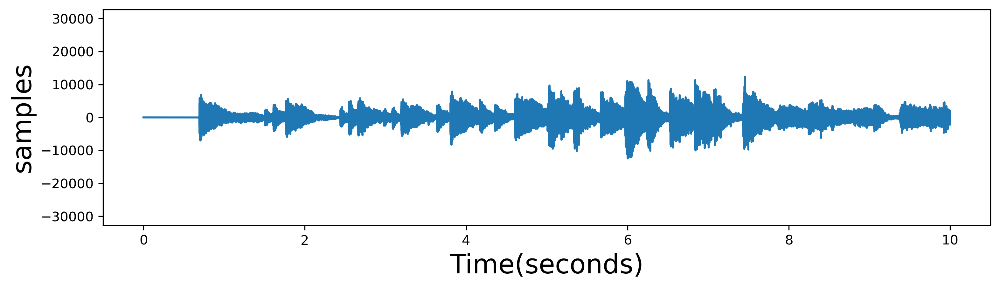

In [75]:
#get the info for chopin sound
rate,csamples = wavfile.read("chopin.wav")
chopin1 = SoundWave(rate, csamples)
chopin1.export("chopin1.wav")
chopin1.plot()
IPython.display.Audio(filename="chopin1.wav")

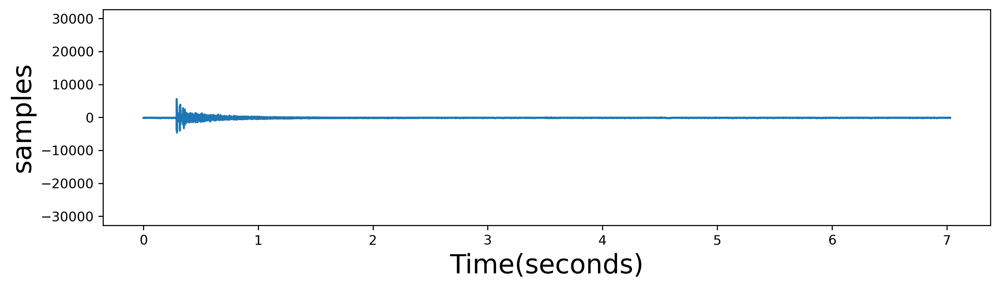

In [76]:
#get the sound of balloon
rate,bsamples = wavfile.read("balloon.wav")
balloon1 = SoundWave(rate, bsamples)
balloon1.export("balloon1.wav")
balloon1.plot()
IPython.display.Audio(filename="balloon1.wav")

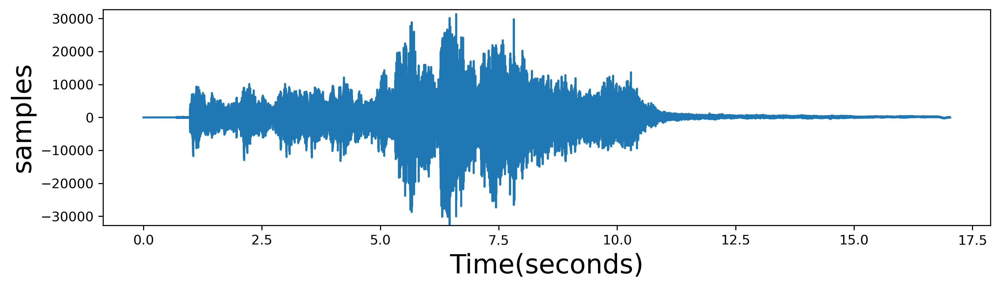

In [77]:
#convolve ballooon and chopin
q4_sample = signal.fftconvolve(csamples, bsamples)
q4= SoundWave(rate, q4_sample)
q4.export("q4.wav")
q4.plot()
IPython.display.Audio(filename="q4.wav")

### Problem 2.4

- Implement `SoundWave.clean()`.
- Clean `noisy1.wav` by filtering out frequencies from $1250$-$2600$ Hz. Embed the original and the cleaned versions in the notebook.
- Clean `noisy2.wav`. Embed the original and the cleaned versions in the notebook.

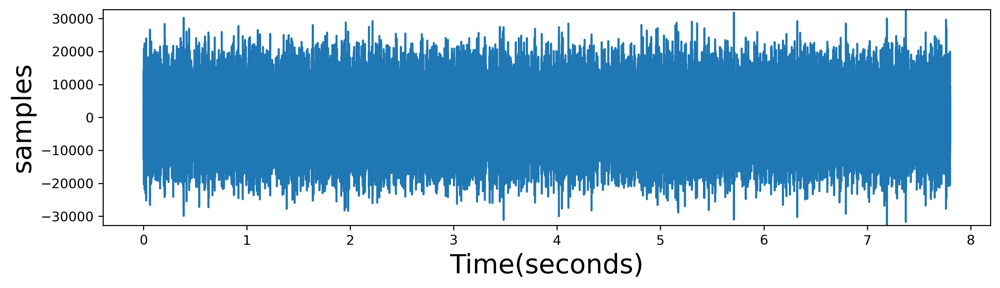

In [78]:
#get noisy1 sound
rate,samples1 = wavfile.read("noisy1.wav")
noisy_1 = SoundWave(rate, samples1)
noisy_1.export("noisy_1.wav")
noisy_1.plot()
IPython.display.Audio(filename="noisy_1.wav")

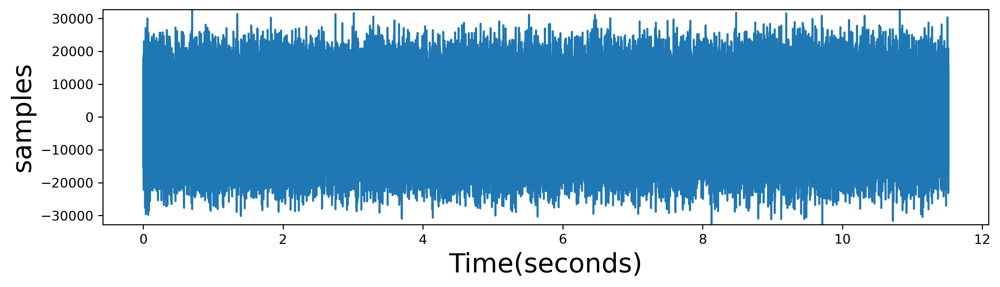

In [79]:
#get noisy2 sound
rate,samples2 = wavfile.read("noisy2.wav")
noisy_2 = SoundWave(rate, samples2)
noisy_2.export("noisy_2.wav")
noisy_2.plot()

IPython.display.Audio(filename="noisy_2.wav")

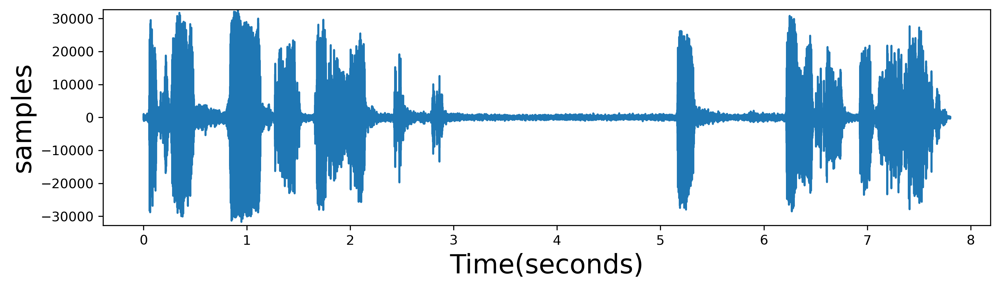

In [80]:
#clean the noisy1
noisy_1.clean(1250,2600)
noisy1_cc = SoundWave(noisy_1.rate, noisy_1.samples)
noisy1_cc.export("noisy1_cc.wav")
noisy1_cc.plot()
IPython.display.Audio(filename="noisy1_cc.wav")

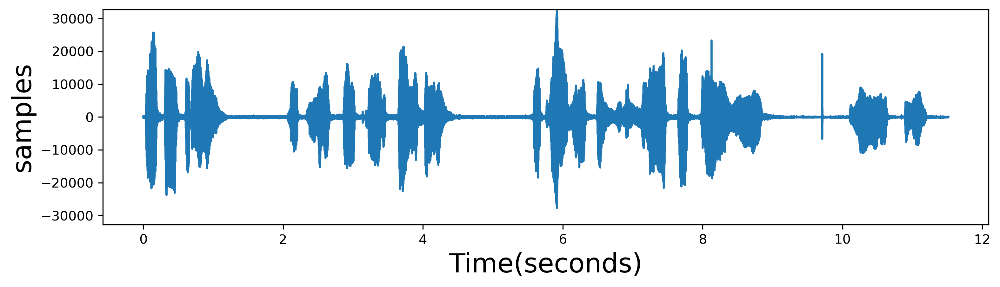

In [81]:
#clean the noisy2
noisy_2.clean(1300,6000)
noisy2_cc = SoundWave(noisy_2.rate, noisy_2.samples)
noisy2_cc.export("noisy2_cc.wav")
noisy2_cc.plot()
IPython.display.Audio(filename="noisy2_cc.wav")

### Problem 2.5

- Clean `vuvuzela.wav` by filtering bad frequencies out of the left and right channels individually.
- Recombine the left and right channels and embed the result in the notebook.

In [82]:
#get vuvuzela sound
rate,samples = wavfile.read("vuvuzela.wav")
vuvuze = SoundWave(rate, samples)
IPython.display.Audio(filename="vuvuzela.wav")

In [83]:
#get the left vuvuzela 
clean1 = SoundWave(rate, samples[:,0])
#get the right vuvuzela 
clean2 = SoundWave(rate, samples[:,1])
clean1.export("clean1.wav")
clean2.export("clean2.wav")
IPython.display.Audio(filename="clean1.wav")

In [84]:
#what clean1 sound like
clean1.clean(200,500)
clean1.export("clean1c.wav")
IPython.display.Audio(filename="clean1c.wav")

In [85]:
#what clean2 sound like
clean2.clean(200,500)
clean2.export("clean2c.wav")
IPython.display.Audio(filename="clean2c.wav")

In [86]:
#vstack both clean1 and clean2 
new_comb = SoundWave(rate, np.vstack((clean1.samples, clean2.samples)).T)
new_comb.export("new_comb.wav")
IPython.display.Audio(filename="new_comb.wav")

### Problem 2.6

- Clean up `license_plate.png` so that the year printed on the sticker in the bottom right corner of the plate is legible.
- Display the original and cleaned images.

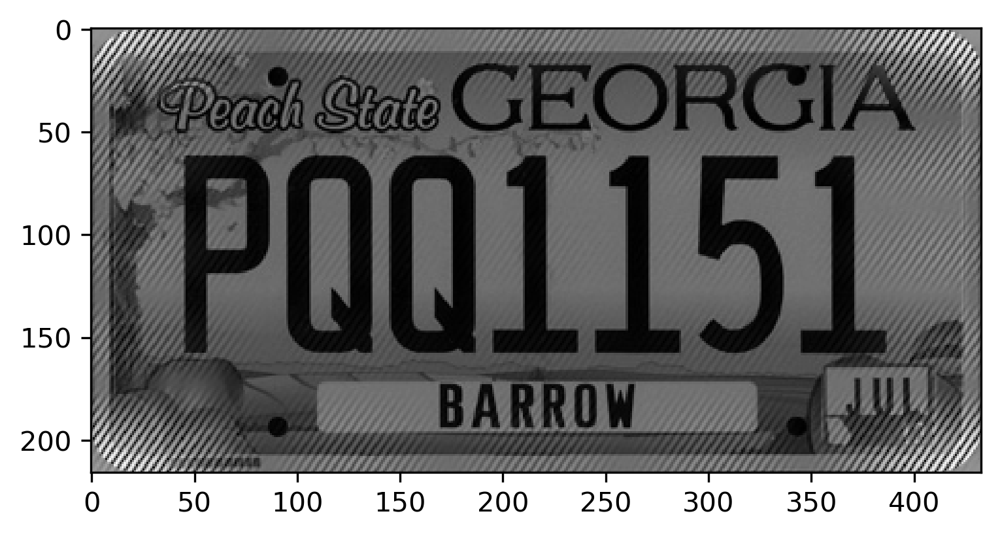

In [87]:
#read the image
image = imageio.imread("license_plate.png")
plt.imshow(image, cmap="gray")
plt.show()

(146.0000000000001-1.089122044719955e-15j)


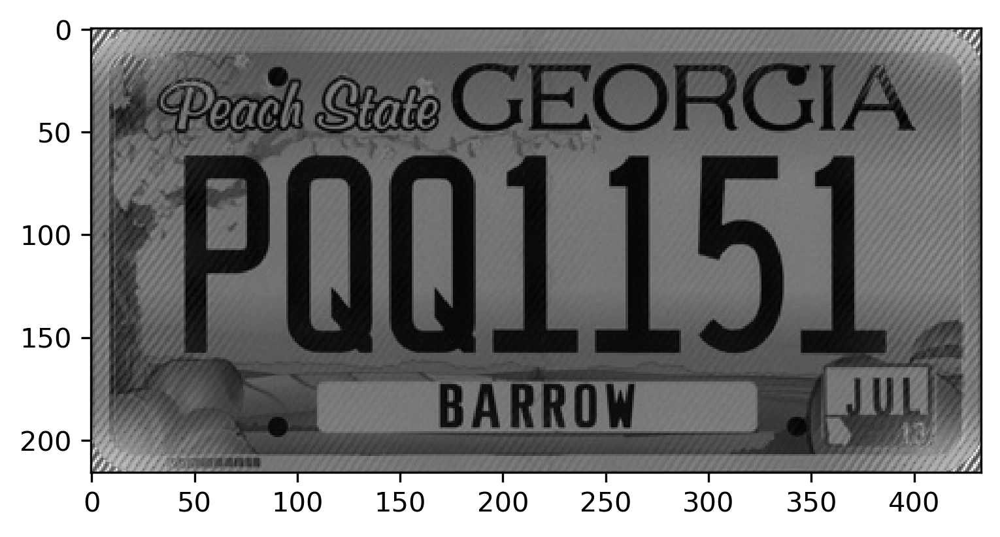

In [88]:
#take dft of the image
#rate, 
pic_dft = fft2(image)
#find the spikes
plt.imshow(np.log(np.abs(pic_dft)), cmap="gray")

mean = np.mean(pic_dft)
print(mean)

#cover the white points
pic_dft[33:38,99:104]= np.mean(pic_dft)
pic_dft[105:115,125:135]= np.mean(pic_dft)
pic_dft[65:75,197:207]= np.mean(pic_dft)
pic_dft[143:153,228:237]= np.mean(pic_dft)
pic_dft[101:110,300:308]= np.mean(pic_dft)
pic_dft[180:190,330:340]= np.mean(pic_dft)

#plt.imshow(np.log(np.abs(pic_dft)), cmap = "gray")
new_i = ifft2(pic_dft).real

plt.imshow(new_i,cmap="gray")
plt.show()

#13

The year on the sticker is...13